In [ ]:
# %% Use trained AstroCLIP model to embed entire dataset

from tqdm import tqdm
import lightning as L
from lightning.pytorch.callbacks import ModelCheckpoint
import torch
from datasets import load_dataset
from pl_bolts.models.self_supervised import Moco_v2
import torch.nn.functional as F
import torch.optim.lr_scheduler as lr_scheduler
from src.models import OutputExtractor, ExtendedSpender, AstroCLIP
from torch.utils.data import Subset, DataLoader
from torchvision.transforms import (
    Compose,
    RandomVerticalFlip,
    RandomHorizontalFlip,
    RandomRotation,
    RandomErasing,
    ToTensor,
    CenterCrop,
    ToPILImage,
    InterpolationMode,
)
from pytorch_lightning.loggers import WandbLogger
import numpy as np
from src.utils import dr2_rgb

import matplotlib.pyplot as plt

print("imports done")

c:\Users\Andre\anaconda3\envs\astroclip_2\Lib\site-packages\pl_bolts\__init__.py:11: FutureWarning: In the future `np.object` will be defined as the corresponding NumPy scalar.
  if not hasattr(numpy, tp_name):
c:\Users\Andre\anaconda3\envs\astroclip_2\Lib\site-packages\pl_bolts\__init__.py:11: FutureWarning: In the future `np.bool` will be defined as the corresponding NumPy scalar.
  if not hasattr(numpy, tp_name):


imports done


c:\Users\Andre\anaconda3\envs\astroclip_2\Lib\site-packages\pl_bolts\models\self_supervised\amdim\amdim_module.py:34: UnderReviewWarning: The feature generate_power_seq is currently marked under review. The compatibility with other Lightning projects is not guaranteed and API may change at any time. The API and functionality may change without warning in future releases. More details: https://lightning-bolts.readthedocs.io/en/latest/stability.html
  "lr_options": generate_power_seq(LEARNING_RATE_CIFAR, 11),
c:\Users\Andre\anaconda3\envs\astroclip_2\Lib\site-packages\pl_bolts\models\self_supervised\amdim\amdim_module.py:92: UnderReviewWarning: The feature FeatureMapContrastiveTask is currently marked under review. The compatibility with other Lightning projects is not guaranteed and API may change at any time. The API and functionality may change without warning in future releases. More details: https://lightning-bolts.readthedocs.io/en/latest/stability.html
  contrastive_task: Union[Fe

In [ ]:
# %%

CACHE_DIR = "C:\datasets_astroclip"
dataset = load_dataset("src/datasets_files/legacy_survey.py", cache_dir=CACHE_DIR)
dataset.set_format(type="torch", columns=["image", "spectrum", "redshift"])

testdata = DataLoader(dataset["test"], batch_size=512, shuffle=False, num_workers=0)

<>:2: SyntaxWarning: invalid escape sequence '\d'
<>:2: SyntaxWarning: invalid escape sequence '\d'
C:\Users\Andre\AppData\Local\Temp\ipykernel_13928\867760402.py:2: SyntaxWarning: invalid escape sequence '\d'
  CACHE_DIR = "C:\datasets_astroclip"
c:\Users\Andre\anaconda3\envs\astroclip_2\Lib\site-packages\datasets\load.py:922: FutureWarning: The repository for legacy_survey contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at src/datasets_files/legacy_survey.py
You can avoid this message in future by passing the argument `trust_remote_code=True`.
Passing `trust_remote_code=True` will be mandatory to load this dataset from the next major release of `datasets`.
  warnings.warn(


In [ ]:
# %%

# Load the embeddings
emb = np.load("data/embeddings.npz")
images = emb["images"]
im_embeddings = emb["im_embeddings"]
spectra = emb["spectra"]
redshifts = emb["redshifts"]
source_spec = emb["source_spec"]

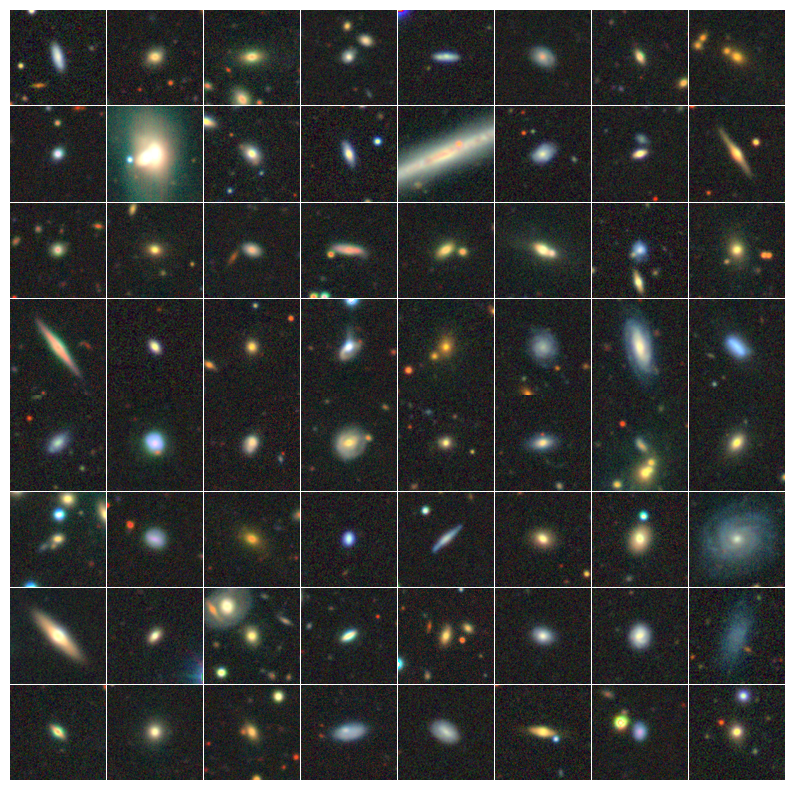

In [ ]:
# %%Plot the first 64 images

plt.figure(figsize=[10, 10])
for i in range(8):
    for j in range(8):
        plt.subplot(8, 8, i * 8 + j + 1)
        plt.imshow(images[i * 8 + j])
        plt.axis("off")
plt.subplots_adjust(wspace=0.01, hspace=0.01)

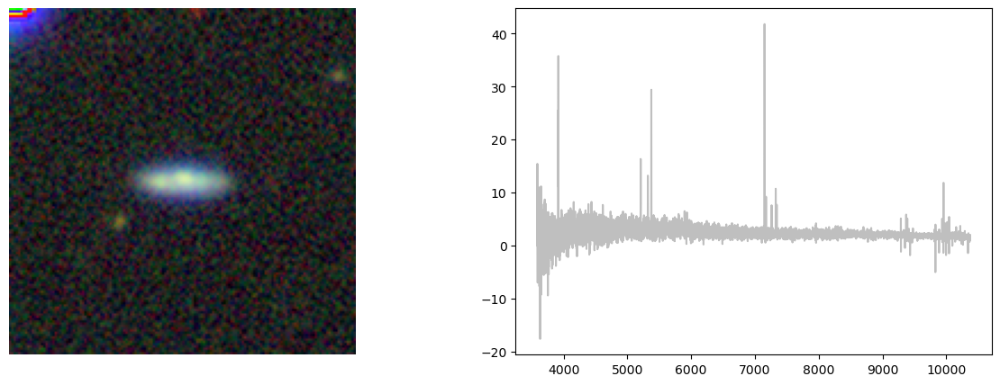

In [ ]:
# %%

l = np.linspace(3586.7408577, 10372.89543574, len(source_spec[0]))
ind_query = 4
plt.figure(figsize=[15, 5])
plt.subplot(1, 2, 1)
plt.imshow(images[ind_query])
plt.axis("off")
plt.subplot(1, 2, 2)
plt.plot(l, source_spec[ind_query], color="grey", alpha=0.5)

# normalise the embedding by diving by the L2 norm
image_features = im_embeddings / np.linalg.norm(im_embeddings, axis=-1, keepdims=True)
spectra_features = spectra / np.linalg.norm(spectra, axis=-1, keepdims=True)
# compute the similarity between the query spectrum and all the image embeddings (i.e. dot product)
cross_similarity = (
    spectra_features[ind_query] @ image_features.T
)  # vector of similarity scores

Query with spectrum-> image cross similarity


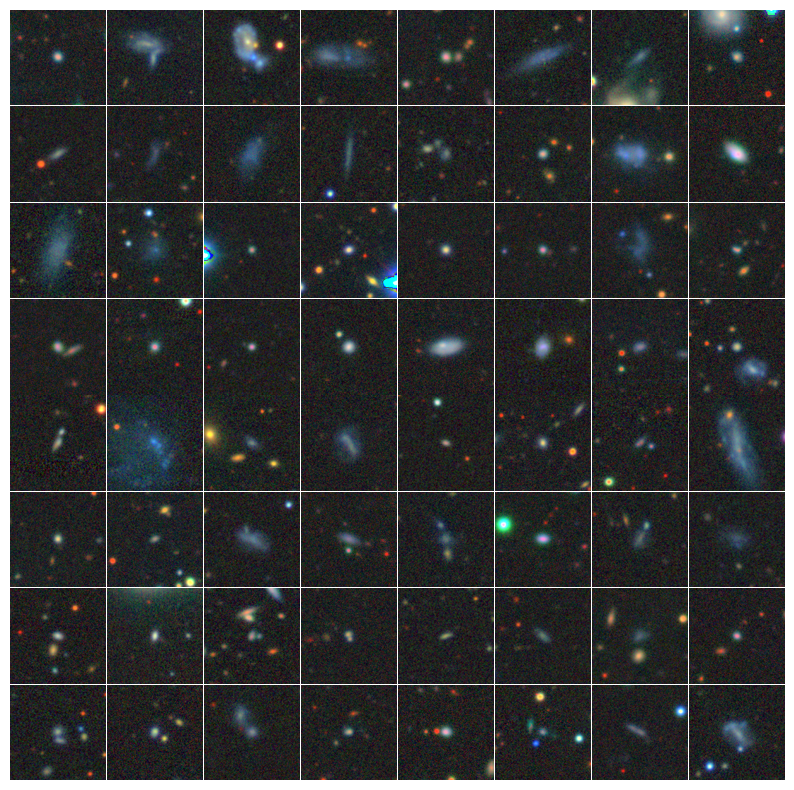

In [ ]:
# %% Spectrum query -> top 64 image retrieval

# Sort the indices of the 'similarity' array in descending order
print("Query with spectrum-> image cross similarity")
ind_sorted = np.argsort(cross_similarity)[::-1]
plt.figure(figsize=[10, 10])
for i in range(8):
    for j in range(8):
        plt.subplot(8, 8, i * 8 + j + 1)
        plt.imshow(images[ind_sorted[i * 8 + j]])
        plt.axis("off")
plt.subplots_adjust(wspace=0.01, hspace=0.01)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


array([[[2.55000000e+02, 2.55000000e+02, 2.55000000e+02],
        [2.55000000e+02, 2.55000000e+02, 2.55000000e+02],
        [2.55000000e+02, 2.55000000e+02, 2.55000000e+02],
        ...,
        [2.55000000e+02, 2.55000000e+02, 2.55000000e+02],
        [2.55000000e+02, 2.55000000e+02, 2.55000000e+02],
        [2.55000000e+02, 2.55000000e+02, 2.55000000e+02]],

       [[2.55000000e+02, 2.55000000e+02, 2.55000000e+02],
        [2.55000000e+02, 2.55000000e+02, 2.55000000e+02],
        [2.55000000e+02, 2.55000000e+02, 2.55000000e+02],
        ...,
        [2.55000000e+02, 2.55000000e+02, 2.55000000e+02],
        [2.55000000e+02, 2.55000000e+02, 2.55000000e+02],
        [2.55000000e+02, 2.55000000e+02, 2.55000000e+02]],

       [[2.55000000e+02, 2.55000000e+02, 2.55000000e+02],
        [2.55000000e+02, 2.55000000e+02, 2.55000000e+02],
        [2.55000000e+02, 2.55000000e+02, 2.55000000e+02],
        ...,
        [2.55000000e+02, 2.55000000e+02, 2.55000000e+02],
        [2.55000000e+02, 2.55

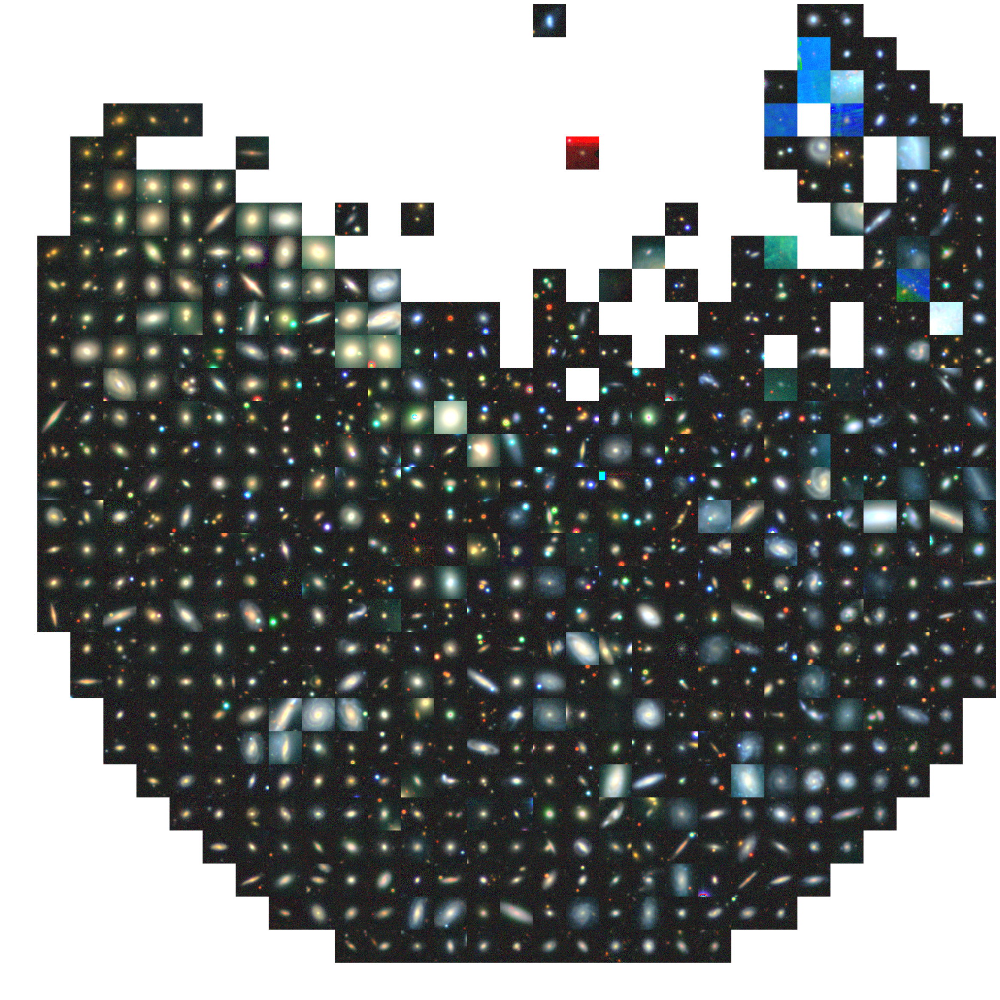

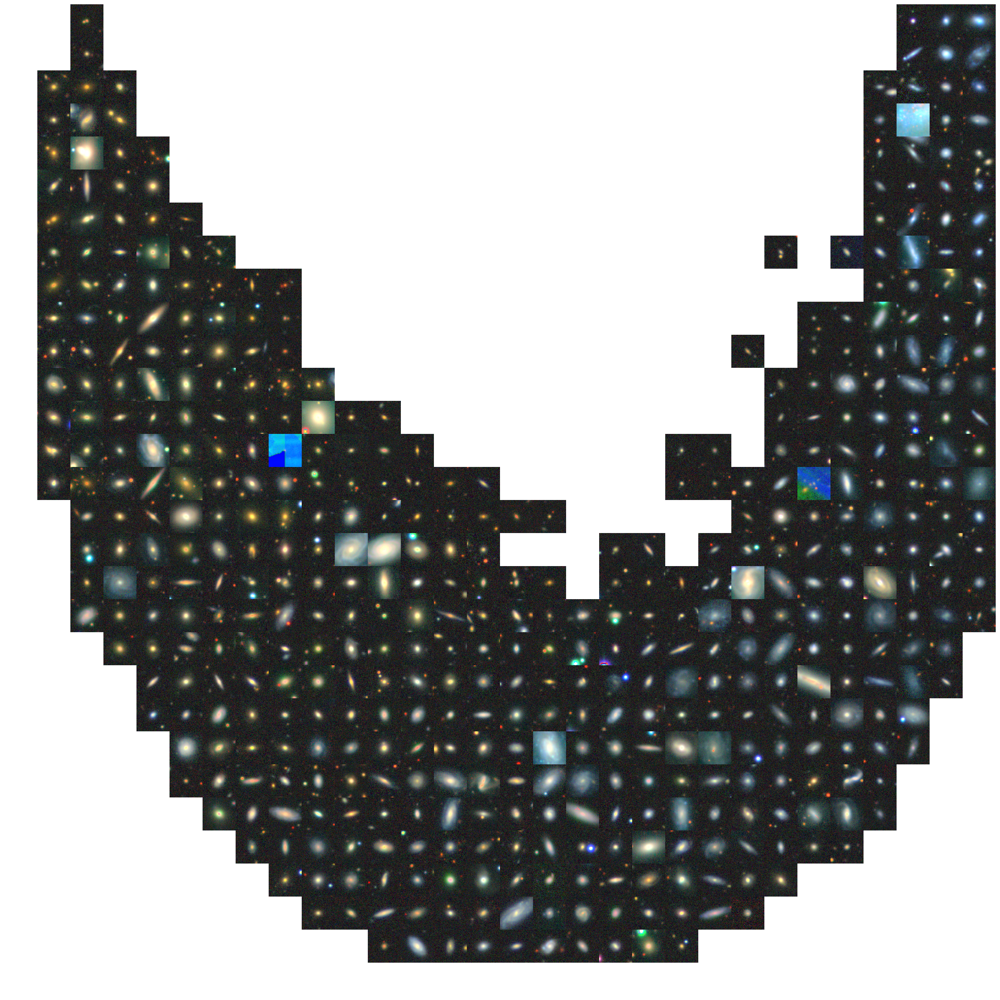

In [ ]:
# %% visualise the embeddings

from sklearn.decomposition import PCA
from src.utils import scatter_plot_as_images
from sklearn.neighbors import NearestNeighbors
from matplotlib.pyplot import plot, ylim, title, legend

im_pca = PCA(n_components=4).fit_transform(image_features)
sp_pca = PCA(n_components=4).fit_transform(spectra_features)
scatter_plot_as_images(im_pca, images, nx=30, ny=30)
scatter_plot_as_images(sp_pca, images, nx=30, ny=30)

<ipython-input-8-84126f768d40>:13: UserWarning: The use of `x.T` on tensors of dimension other than 2 to reverse their shape is deprecated and it will throw an error in a future release. Consider `x.mT` to transpose batches of matrices or `x.permute(*torch.arange(x.ndim - 1, -1, -1))` to reverse the dimensions of a tensor. (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\TensorShape.cpp:3641.)
  plt.imshow(crop(torch.tensor(images[ind_query]).T).T)


Text(0.5, 1.0, 'Queried Spectrum')

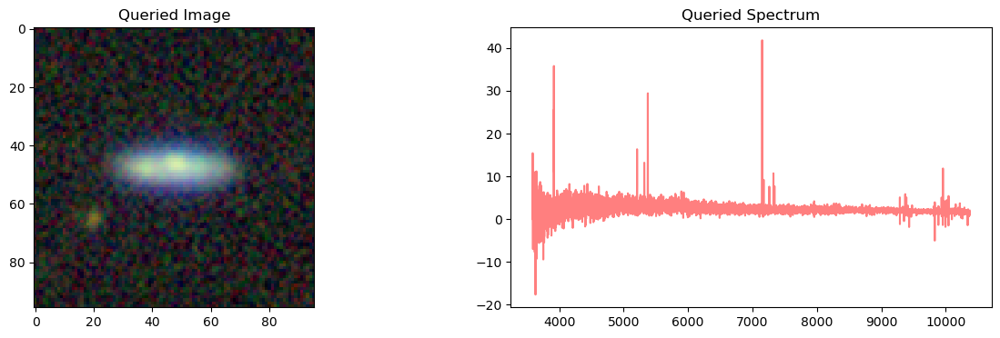

In [ ]:
# %% Nearest Neighbour retrieval

ind_query = 4

spectral_similarity = spectra_features[ind_query] @ spectra_features.T
image_similarity = image_features[ind_query] @ image_features.T
cross_image_similarity = image_features[ind_query] @ spectra_features.T
cross_spectral_similarity = spectra_features[ind_query] @ image_features.T

crop = CenterCrop(96)

plt.figure(figsize=[15, 4])
plt.subplot(121)
plt.imshow(crop(torch.tensor(images[ind_query]).T).T)
plt.title("Queried Image")
plt.subplot(122)
plt.plot(l, source_spec[ind_query], color="red", alpha=0.5)
plt.title("Queried Spectrum")
# plt.ylim(-0, 20)

Query with spectral similarity:


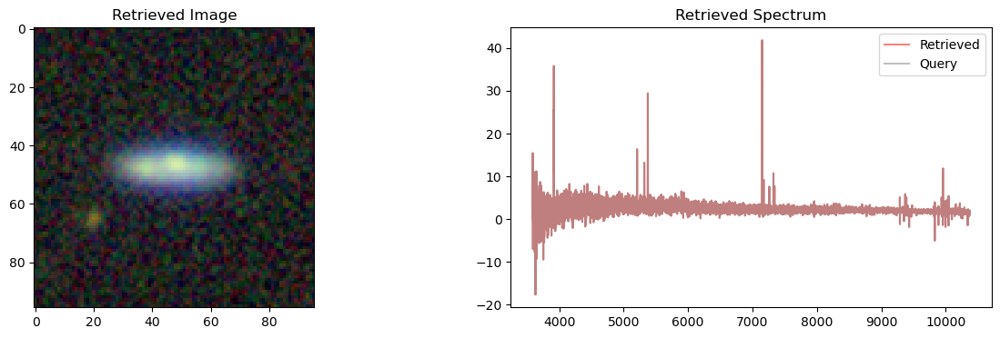

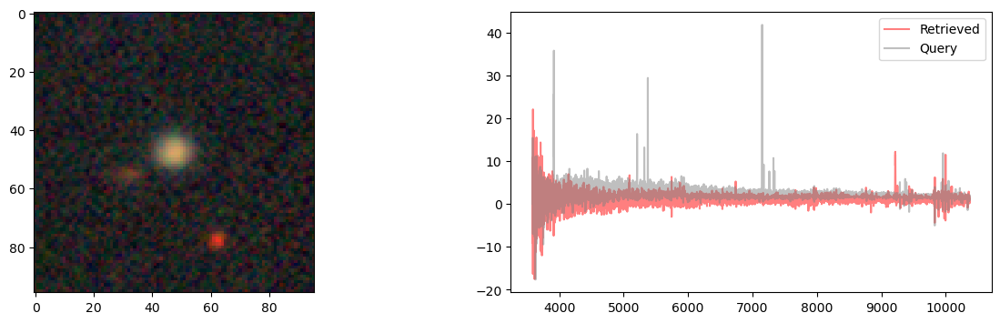

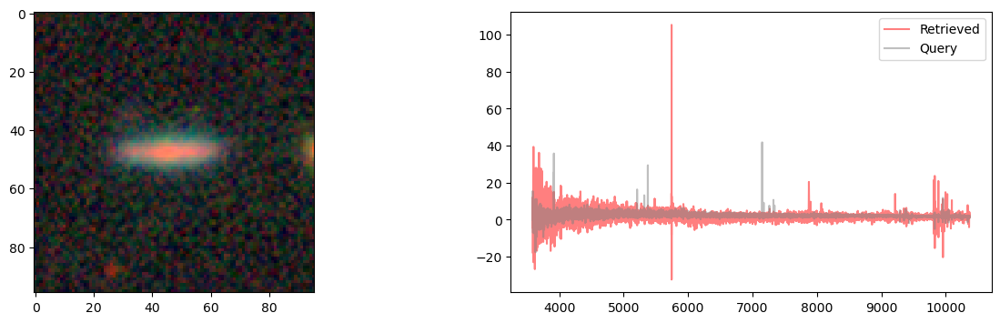

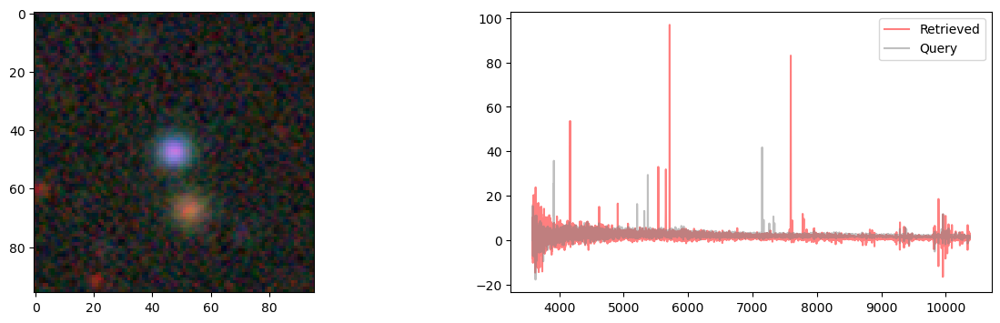

In [ ]:
# %% Query with spectral similarity

inds = np.argsort(spectral_similarity)[::-1]
print("Query with spectral similarity:")
for i in range(4):
    plt.figure(figsize=[15, 4])
    plt.subplot(121)
    plt.imshow(crop(torch.tensor(images[inds[i]]).T).T)
    if i == 0:
        plt.title("Retrieved Image")
    plt.subplot(122)
    plt.plot(l, source_spec[inds[i]], color="red", alpha=0.5, label="Retrieved")
    # plt.ylim(-0, 20)
    plt.plot(l, source_spec[ind_query], color="grey", alpha=0.5, label="Query")

    if i == 0:
        plt.title("Retrieved Spectrum")

    plt.legend()

Query with image similarity:


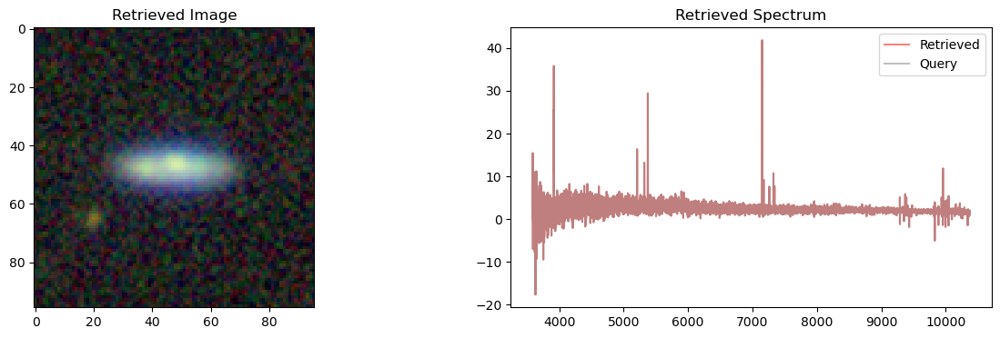

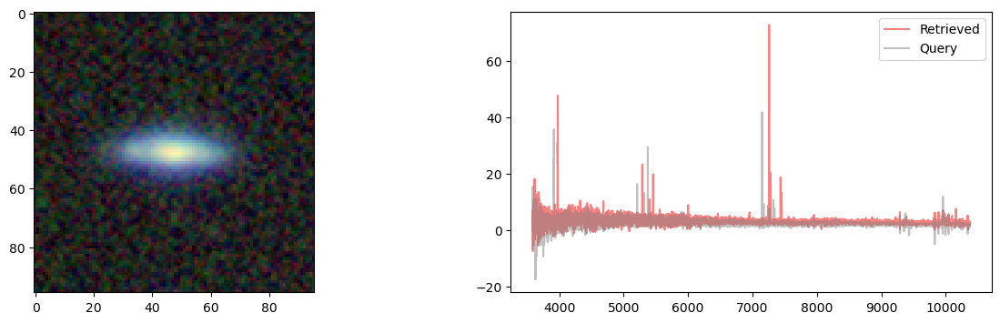

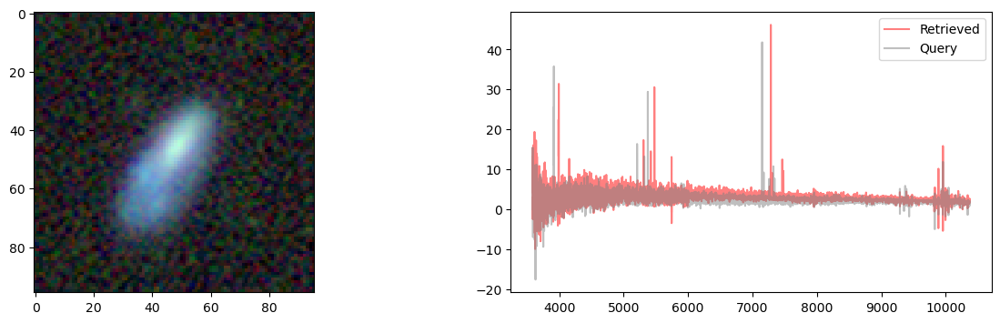

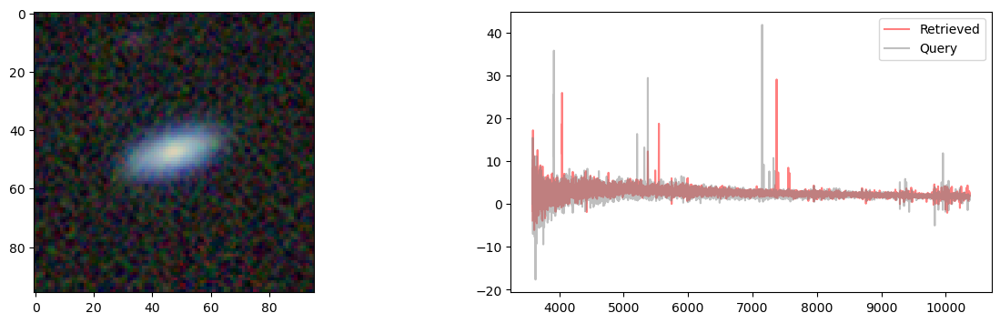

In [ ]:
# %%  Query with image similarity

print("Query with image similarity:")
inds = np.argsort(image_similarity)[::-1]
for i in range(4):
    plt.figure(figsize=[15, 4])
    plt.subplot(121)
    plt.imshow(crop(torch.tensor(images[inds[i]]).T).T)
    if i == 0:
        plt.title("Retrieved Image")
    plt.subplot(122)
    plt.plot(l, source_spec[inds[i]], color="red", alpha=0.5, label="Retrieved")
    # plt.ylim(-0, 20)
    plt.plot(l, source_spec[ind_query], color="grey", alpha=0.5, label="Query")

    if i == 0:
        plt.title("Retrieved Spectrum")

    plt.legend()

Query with image->spectrum similarity:


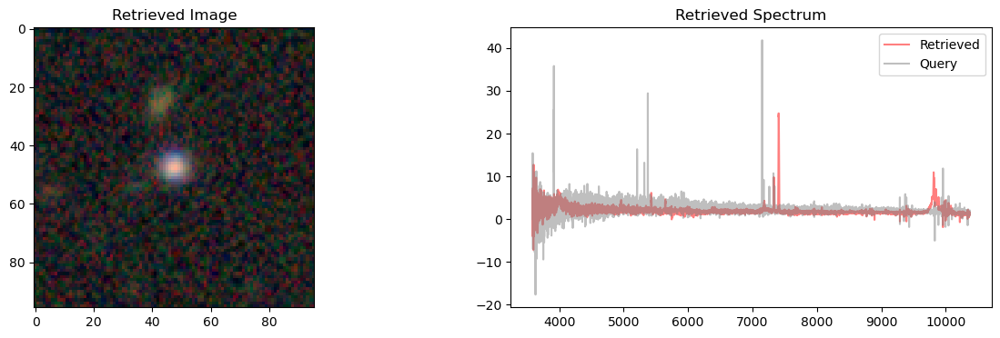

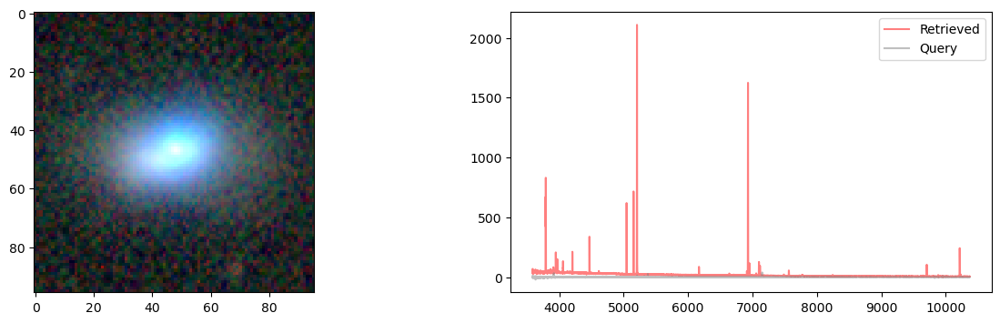

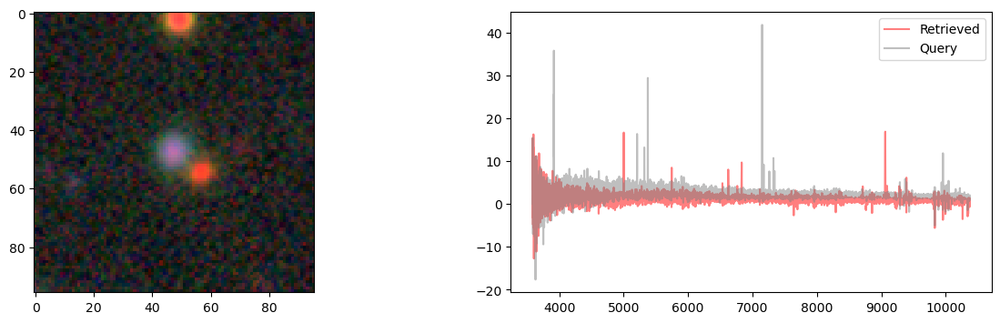

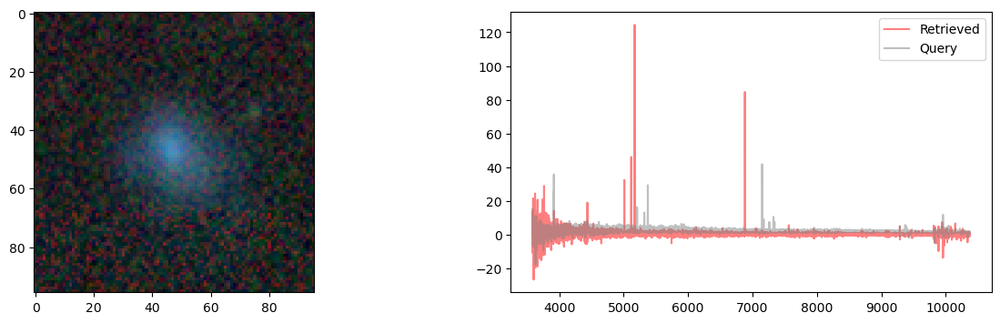

In [ ]:
# %% Query with cross similarity

print("Query with image->spectrum similarity:")
inds = np.argsort(cross_image_similarity)[::-1]
for i in range(4):
    plt.figure(figsize=[15, 4])
    plt.subplot(121)
    plt.imshow(crop(torch.tensor(images[inds[i]]).T).T)
    if i == 0:
        plt.title("Retrieved Image")
    plt.subplot(122)
    plt.plot(l, source_spec[inds[i]], color="red", alpha=0.5, label="Retrieved")
    # plt.ylim(-0, 20)
    plt.plot(l, source_spec[ind_query], color="grey", alpha=0.5, label="Query")

    if i == 0:
        plt.title("Retrieved Spectrum")

    plt.legend()

Query with spectrum->image similarity:


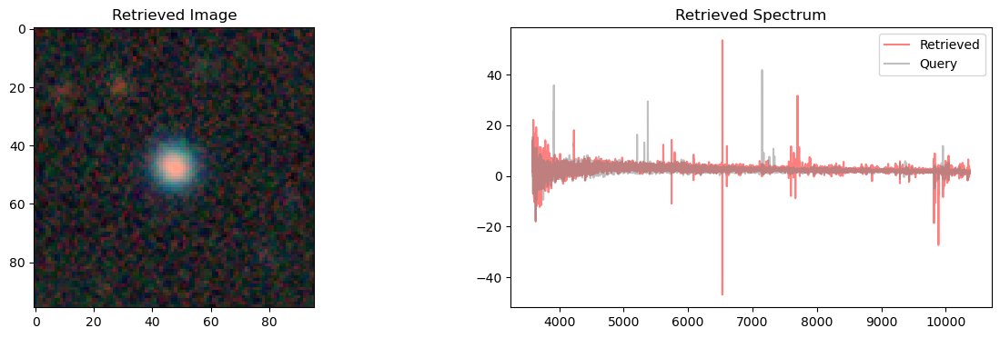

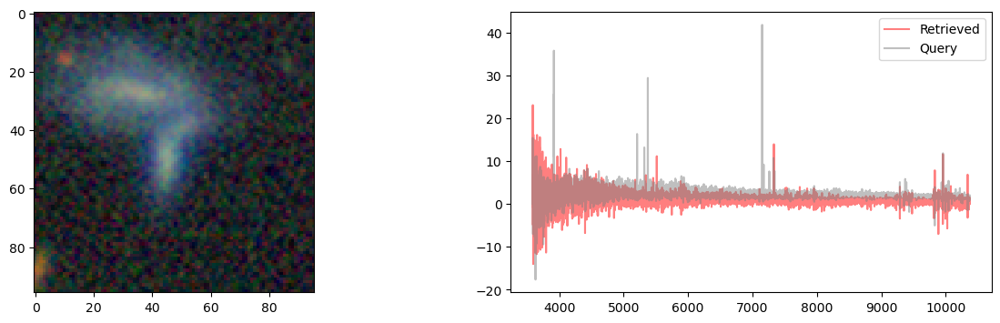

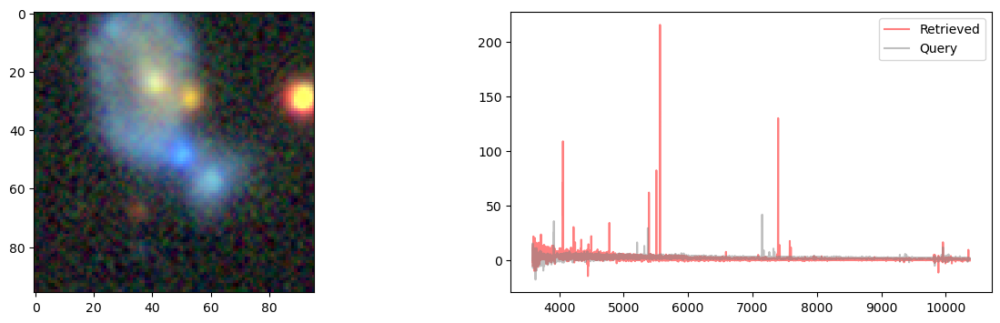

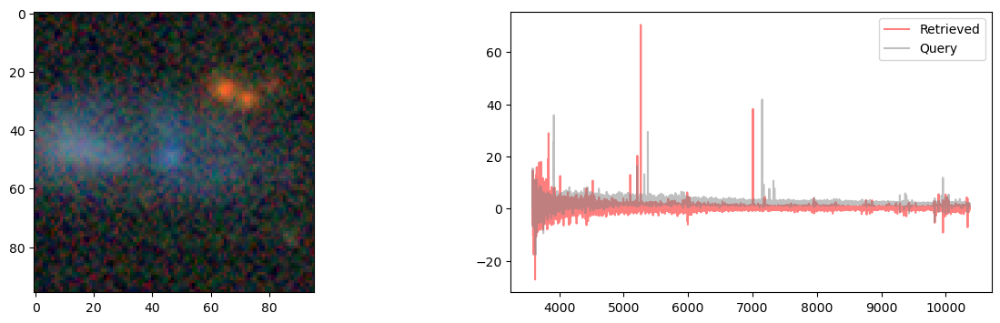

In [ ]:
# %% Query with cross similarity

print("Query with spectrum->image similarity:")
inds = np.argsort(cross_spectral_similarity)[::-1]
for i in range(4):
    plt.figure(figsize=[15, 4])
    plt.subplot(121)
    plt.imshow(crop(torch.tensor(images[inds[i]]).T).T)
    if i == 0:
        plt.title("Retrieved Image")
    plt.subplot(122)
    plt.plot(l, source_spec[inds[i]], color="red", alpha=0.5, label="Retrieved")
    # plt.ylim(-0, 20)
    plt.plot(l, source_spec[ind_query], color="grey", alpha=0.5, label="Query")

    if i == 0:
        plt.title("Retrieved Spectrum")

    plt.legend()

In [ ]:
# %%

# from astropy.table import Table, join

# import h5py

# # Open the HDF5 file
# file_path = 'C:\datasets_astroclip\lgal_fsps.mocha.v1.3.hdf5'
# hdf5_file = h5py.File(file_path, 'r')

# # Function to recursively print all groups and datasets
# def print_hdf5_structure(name, obj):
#     print(name)

# # Print the structure of the HDF5 file
# hdf5_file.visititems(print_hdf5_structure)

# # Close the file
# hdf5_file.close()

# # provabgs = Table.read("C:\datasets_astroclip\lgal_fsps.mocha.v1.3.hdf5")

c:\Users\Andre\anaconda3\envs\astroclip_2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\Andre\anaconda3\envs\astroclip_2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\Andre\anaconda3\envs\astroclip_2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\Andre\anaconda3\envs\astroclip_2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be rem

Text(0.05, 0.55, '$R^2$ score: 0.05')

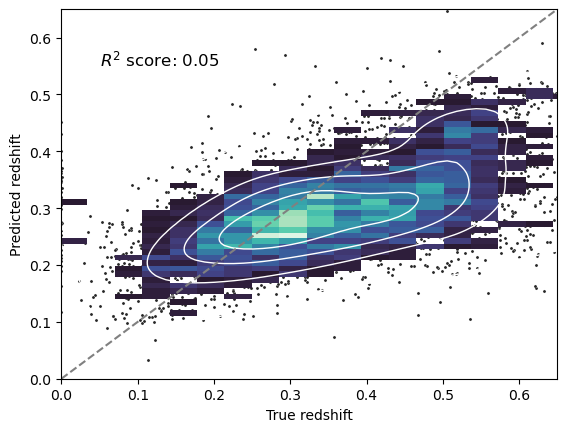

In [ ]:
# %% Zero shot redshift prediction

from sklearn.neighbors import KNeighborsRegressor
import seaborn as sns
from sklearn.metrics import r2_score

neigh = KNeighborsRegressor(weights="distance", n_neighbors=16)
neigh.fit(image_features[:-5000], redshifts[:-5000])
preds = neigh.predict(image_features[-5000:])


sns.scatterplot(x=redshifts[-5000:], y=preds, s=5, color=".15")
sns.histplot(x=redshifts[-5000:], y=preds, bins=64, pthresh=0.1, cmap="mako")
sns.kdeplot(x=redshifts[-5000:], y=preds, levels=5, color="w", linewidths=1)
plt.xlabel("True redshift")
plt.ylabel("Predicted redshift")
plt.plot([0, 1], [0, 1], color="grey", linestyle="--")
plt.xlim(0, 0.65)
plt.ylim(0, 0.65)
plt.text(
    0.05,
    0.55,
    "$R^2$ score: %0.2f" % (r2_score(redshifts[-5000:], preds)),
    fontsize="large",
)

c:\Users\Andre\anaconda3\envs\astroclip_2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\Andre\anaconda3\envs\astroclip_2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\Andre\anaconda3\envs\astroclip_2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\Andre\anaconda3\envs\astroclip_2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be rem

Text(0.05, 0.55, '$R^2$ score: -0.61')

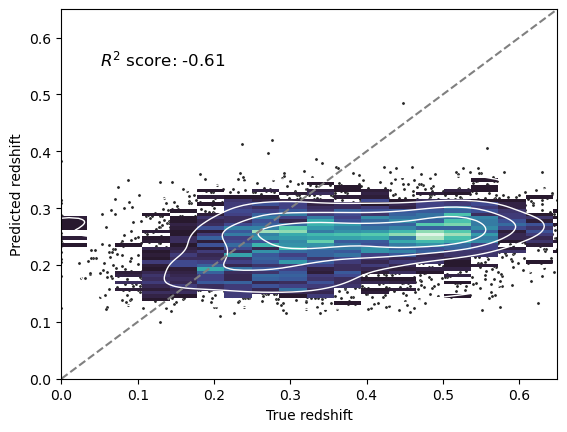

In [ ]:
# %% from spectra

neigh = KNeighborsRegressor(weights="distance", n_neighbors=16)
neigh.fit(spectra[:-5000], redshifts[:-5000])
preds = neigh.predict(spectra[-5000:])
sns.scatterplot(x=redshifts[-5000:], y=preds, s=5, color=".15")
sns.histplot(x=redshifts[-5000:], y=preds, bins=64, pthresh=0.1, cmap="mako")
sns.kdeplot(x=redshifts[-5000:], y=preds, levels=5, color="w", linewidths=1)
plt.xlabel("True redshift")
plt.ylabel("Predicted redshift")
plt.plot([0, 1], [0, 1], color="grey", linestyle="--")
plt.xlim(0, 0.65)
plt.ylim(0, 0.65)
plt.text(
    0.05,
    0.55,
    "$R^2$ score: %0.2f" % (r2_score(redshifts[-5000:], preds)),
    fontsize="large",
)